In [1]:
%load_ext autoreload
%autoreload 2

from pathlib import Path
from pprint import pformat

from hloc import extract_features, match_features, pairs_from_covisibility, pairs_from_retrieval, pairs_from_poses, pairs_from_exhaustive
from hloc import reconstruction, triangulation, localize_sfm, visualization

from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

import os

# Pipeline for Scan Capture data

## Data Setup
Here we declare the paths to the dataset, the reconstruction and localization outputs, and we choose the feature extractor and the matcher. 

In [2]:
# Set all paths

site_id = 'TestTrack'

data_root = Path('/home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA')
capture_path = data_root / site_id
scan_capture_path = capture_path / 'ScanCapture'

sequence_id = '2023-12-18_15.06.36' # Closes well
sequence_recording_path = scan_capture_path / sequence_id

from scantools import run_phone_to_capture
from scantools.capture import Capture

capture = Capture.load(capture_path)

recorded_colmap_output = capture.session_path(sequence_id) / 'recorded_model'
recorded_colmap_output_txt = capture.session_path(sequence_id) / 'recorded_model_txt'


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


[2024/01/17 16:48:02 scantools INFO] Loading Capture from /home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA/TestTrack.


In [4]:
# Create capture object

chunk_ids = run_phone_to_capture.run(input_path=sequence_recording_path, 
                                     capture=capture, 
                                     session_id=sequence_id, 
                                     visualize=True, 
                                     downsample_framerate=5, 
                                     split_sequence_on_failure=False)


AssertionError: 2023-12-18_15.06.36

In [14]:
from scantools import run_capture_to_empty_colmap

run_capture_to_empty_colmap.run(capture=capture, 
                                session_ids=[sequence_id], 
                                output_path=recorded_colmap_output,
                                ext='.txt')


[2024/01/15 21:10:57 scantools INFO] Writing COLMAP empty .txt reconstruction to /home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA/TestTrack/sessions/2023-12-18_15.06.36/recorded_model_txt.


In [4]:
import pycolmap

initial_model = pycolmap.Reconstruction(recorded_colmap_output)

import plotly.graph_objects as go

fig = viz_3d.init_figure()

# Add axes at the origin
fig.add_trace(go.Scatter3d(
    x=[0, 1],
    y=[0, 0],
    z=[0, 0],
    mode="lines",
    line=dict(color="red", width=10),
    showlegend=False  # Hide from legend
))  # Positive X-axis

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 1],
    z=[0, 0],
    mode="lines",
    line=dict(color="green", width=10),
    showlegend=False
))  # Positive Y-axis

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 0],
    z=[0, 1],
    mode="lines",
    line=dict(color="cyan", width=10),
    showlegend=False
))  # Positive Z-axis

# Set camera as BEV, in ARKit 
scene_camera = dict(
    up=dict(x=0, y=0, z=-1),  # Up direction (default is z-axis)
    center=dict(x=0, y=0, z=0),  # Center of scene (default is origin)
    eye=dict(x=0, y=5, z=0),  # Camera position (adjust as needed)
    projection=dict(type="perspective")
)
fig.update_layout(scene_camera=scene_camera)

viz_3d.plot_cameras(fig, initial_model)

fig.show()


In [5]:
# Model building

dataset = capture.session_path(sequence_id)  # where the dataset is
images  = dataset / 'raw_data' / 'images'
outputs = dataset / 'outputs'  # where everything will be saved

sfm_pairs = outputs / 'pairs-db-covis20.txt'  # top 20 most covisible in SIFT model
loc_pairs = outputs / 'pairs-query-netvlad20.txt'  # top 20 retrieved by NetVLAD
reference_sfm = outputs / 'sfm_superpoint+superglue'  # the SfM model we will build
results = outputs / 'hloc_superpoint+superglue_netvlad20.txt'  # the result file
sfm_dir = outputs / 'sfm'

# list the standard configurations available
print(f'Configs for feature extractors:\n{pformat(extract_features.confs)}')
print(f'Configs for feature matchers:\n{pformat(match_features.confs)}')

Configs for feature extractors:
{'cosplace': {'model': {'name': 'cosplace'},
              'output': 'global-feats-cosplace',
              'preprocessing': {'resize_max': 1024}},
 'd2net-ss': {'model': {'multiscale': False, 'name': 'd2net'},
              'output': 'feats-d2net-ss',
              'preprocessing': {'grayscale': False, 'resize_max': 1600}},
 'dir': {'model': {'name': 'dir'},
         'output': 'global-feats-dir',
         'preprocessing': {'resize_max': 1024}},
 'disk': {'model': {'max_keypoints': 5000, 'name': 'disk'},
          'output': 'feats-disk',
          'preprocessing': {'grayscale': False, 'resize_max': 1600}},
 'netvlad': {'model': {'name': 'netvlad'},
             'output': 'global-feats-netvlad',
             'preprocessing': {'resize_max': 1024}},
 'openibl': {'model': {'name': 'openibl'},
             'output': 'global-feats-openibl',
             'preprocessing': {'resize_max': 1024}},
 'r2d2': {'model': {'max_keypoints': 5000, 'name': 'r2d2'},
        

In [6]:
# pick one of the configurations for image retrieval, local feature extraction, and matching
# you can also simply write your own here!
retrieval_conf = extract_features.confs['netvlad']
feature_conf = extract_features.confs['disk']
matcher_conf = match_features.confs['disk+lightglue']

## Extract local features for database and query images

In [9]:
features = extract_features.main(feature_conf, images, outputs)

[2024/01/17 16:49:19 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}


[2024/01/17 16:49:19 hloc INFO] Found 341 images in root /home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA/TestTrack/sessions/2023-12-18_15.06.36/raw_data/images.
[2024/01/17 16:49:19 hloc INFO] Skipping the extraction.


The function returns the path of the file in which all the extracted features are stored.

Features were exported to file: /home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA/TestTrack/sessions/2023-12-18_15.06.36/outputs/feats-disk.h5


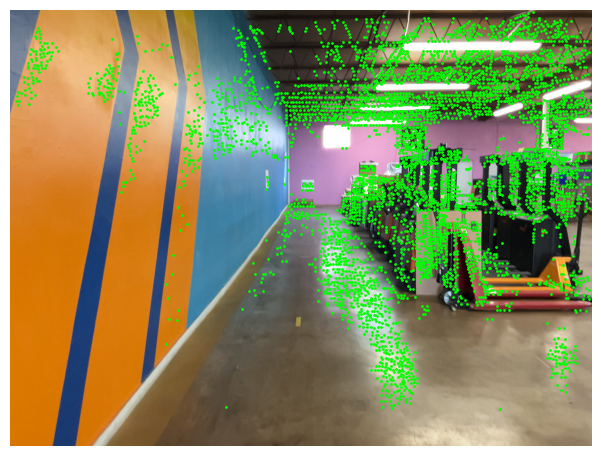

In [10]:
# This is the file where the features were saved
print(f'Features were exported to file: {features}')

# How can we plot the exported features?
from hloc.utils.io import list_h5_names, read_image, get_keypoints
from hloc.utils.viz import plot_images, plot_keypoints

sample_image_names_list = list_h5_names(features)

sample_idx = 20
sample_image_name = sample_image_names_list[sample_idx] #'db/1931.jpg'
sample_image_path = images / sample_image_name
sample_image = read_image(sample_image_path)
sample_image_kps = get_keypoints(features, sample_image_name)

plot_images([sample_image])
plot_keypoints([sample_image_kps])


### Generate pairs for the SfM reconstruction

In [9]:
# # Create pairs using initial colmap poses
# pairs_from_poses.main(
#   dataset / 'colmap_model',
#   sfm_pairs, 
#   num_matched=10,
#   use_text_file=False
# )

# Generate pairs using image-level feature matching
retrieval_path = extract_features.main(retrieval_conf, images, outputs)
pairs_from_retrieval.main(retrieval_path, sfm_pairs, num_matched=5)

#global_descriptors = extract_features.main(retrieval_conf, images, outputs)
#pairs_from_retrieval.main(global_descriptors, loc_pairs, num_matched=20, db_prefix="db", query_prefix="query")

[2024/01/16 13:28:42 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'netvlad'},
 'output': 'global-feats-netvlad',
 'preprocessing': {'resize_max': 1024}}
[2024/01/16 13:28:42 hloc INFO] Found 341 images in root /home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA/TestTrack/sessions/2023-12-18_15.06.36/raw_data/images.


[2024/01/16 13:28:42 hloc INFO] Skipping the extraction.
[2024/01/16 13:28:42 hloc INFO] Extracting image pairs from a retrieval database.
[2024/01/16 13:28:45 hloc INFO] Found 1705 pairs.


### Match the database images

In [10]:
sfm_matches = match_features.main(matcher_conf, sfm_pairs, feature_conf['output'], outputs)

print(f'sfm matches were saved in file {sfm_matches}')

[2024/01/16 13:28:52 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}


[2024/01/16 13:28:52 hloc INFO] Skipping the matching.


sfm matches were saved in file /home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA/TestTrack/sessions/2023-12-18_15.06.36/outputs/feats-disk_matches-disk-lightglue_pairs-db-covis20.h5


The function returns the path of the file in which all the computed matches are stored.

### Triangulate a new SfM model
We triangulate the sparse 3D pointcloud given the matches.

In [11]:
# Reconstruction from matches

model = reconstruction.main(sfm_dir, 
                            images, 
                            sfm_pairs, 
                            features, 
                            sfm_matches)


[2024/01/15 20:31:20 hloc WARNING] The database already exists, deleting it.
[2024/01/15 20:31:20 hloc INFO] Creating an empty database...


[2024/01/15 20:31:20 hloc INFO] Importing images into the database...
[2024/01/15 20:31:26 hloc INFO] Importing features into the database...
100%|██████████| 341/341 [00:00<00:00, 1640.17it/s]
[2024/01/15 20:31:26 hloc INFO] Importing matches into the database...
100%|██████████| 1705/1705 [00:00<00:00, 2231.44it/s]
[2024/01/15 20:31:27 hloc INFO] Performing geometric verification of the matches...
[2024/01/15 20:31:37 hloc INFO] Running 3D reconstruction...
[2024/01/15 21:03:42 hloc INFO] Reconstructed 1 model(s).
[2024/01/15 21:03:42 hloc INFO] Largest model is #0 with 341 images.
[2024/01/15 21:03:42 hloc INFO] Reconstruction statistics:
Reconstruction:
	num_reg_images = 341
	num_cameras = 341
	num_points3D = 120905
	num_observations = 1090694
	mean_track_length = 9.02108
	mean_observations_per_image = 3198.52
	mean_reprojection_error = 1.40137
	num_input_images = 341


In [11]:
import pycolmap

# Load a preexisting model
model = pycolmap.Reconstruction(sfm_dir)


In [12]:

import plotly.graph_objects as go

fig = viz_3d.init_figure()

# Add axes at the origin
fig.add_trace(go.Scatter3d(
    x=[0, 1],
    y=[0, 0],
    z=[0, 0],
    mode="lines",
    line=dict(color="red", width=10),
    showlegend=False  # Hide from legend
))  # Positive X-axis

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 1],
    z=[0, 0],
    mode="lines",
    line=dict(color="green", width=10),
    showlegend=False
))  # Positive Y-axis

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 0],
    z=[0, 1],
    mode="lines",
    line=dict(color="cyan", width=10),
    showlegend=False
))  # Positive Z-axis

# Set camera as BEV, in ARKit 
scene_camera = dict(
    up=dict(x=1, y=0, z=0),  # Up direction (default is z-axis)
    center=dict(x=0, y=0, z=0),  # Center of scene (default is origin)
    eye=dict(x=0, y=-5, z=0),  # Camera position (adjust as needed)
    projection=dict(type="perspective")
)
fig.update_layout(scene_camera=scene_camera)

viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)

fig.show()

## Localize a query image
We extract global descriptors with NetVLAD and find for each image the $k$ most similar ones. A larger $k$ improves the robustness of the localization for difficult queries but makes the matching more expensive. Using $k{=}10{-}20$ is generally a good tradeoff but $k{=}50$ gives the best results for the Aachen Day-Night dataset.

In [13]:
# Query

ref_sequence_id = '2023-12-18_15.06.36' # Closes well
ref_dataset = capture.session_path(ref_sequence_id)  # where the dataset is
ref_images  = ref_dataset / 'raw_data' / 'images'
ref_outputs = ref_dataset / 'outputs'  # where everything will be saved

ref_images_list = [p.relative_to(ref_images).as_posix() for p in (ref_images).iterdir()]

query_sequence_id = '2023-12-18_15.04.25' # Does not close well due to proximity to wall.
query_dataset = capture.session_path(query_sequence_id)  # where the dataset is
query_images  = query_dataset / 'raw_data' / 'images'
query_outputs = query_dataset / 'outputs'  # where everything will be saved

session = capture.sessions[query_sequence_id]
query_ids_list = list(session.trajectories.keys())

image_num = 145
query_id = query_ids_list[image_num]
print(f"query_id = {query_id}")

query_id = 245569833740


In [14]:

query_image = list(session.images[query_id].values())[0]
query_sensor = list(session.images[query_id].keys())[0]
query_camera_params = session.cameras[query_sensor].sensor_params
print(f"Query image '{query_image}' camera params: {query_camera_params}")

query_camera = pycolmap.Camera(model=query_camera_params[0], 
                               width=int(query_camera_params[1]),
                               height=int(query_camera_params[2]),
                               params=[float(query_camera_params[3]), float(query_camera_params[4]), float(query_camera_params[5]), float(query_camera_params[6])],
                               id=0)


# query = f'{query_id}.jpg'

query = '434343434343.jpg'
camera_config = {'model': 'PINHOLE', 'width': 1920, 'height': 1440, 'params': [1597.43, 1597.43, 953.97, 718.76]}
query_camera = pycolmap.Camera(model=camera_config['model'], width=camera_config['width'], height=camera_config['height'], params=camera_config['params'])

query_retrieval_features = query_outputs / 'query_retrieval_features.h5'
query_retrieval_pairs = query_outputs / 'query_retrieval-loc.txt'
query_features = query_outputs / 'query_features.h5'
query_matches = query_outputs / 'query_matches.h5'

# Find matches with retreival
extract_features.main(retrieval_conf, ref_images, image_list=ref_images_list, feature_path=query_retrieval_features)
extract_features.main(retrieval_conf, query_images, image_list=[query], feature_path=query_retrieval_features, overwrite=True)
pairs_from_retrieval.main(query_retrieval_features, query_retrieval_pairs, num_matched=10, query_list=[query])

# Extract local features
extract_features.main(feature_conf, ref_images, image_list=ref_images_list, feature_path=query_features)
extract_features.main(feature_conf, query_images, image_list=[query], feature_path=query_features, overwrite=True)
# Match with closest images
match_features.main(matcher_conf, query_retrieval_pairs, features=query_features, matches=query_matches, overwrite=True)


[2024/01/17 16:54:28 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'netvlad'},
 'output': 'global-feats-netvlad',
 'preprocessing': {'resize_max': 1024}}


[2024/01/17 16:54:29 hloc INFO] Skipping the extraction.
[2024/01/17 16:54:29 hloc INFO] Extracting local features with configuration:
{'model': {'name': 'netvlad'},
 'output': 'global-feats-netvlad',
 'preprocessing': {'resize_max': 1024}}


Query image 'images/245569833740.jpg' camera params: ['PINHOLE', '1920', '1440', '1596.080444', '1596.080444', '953.839783', '718.780945']


100%|██████████| 1/1 [00:03<00:00,  3.33s/it]
[2024/01/17 16:54:41 hloc INFO] Finished exporting features.
[2024/01/17 16:54:41 hloc INFO] Extracting image pairs from a retrieval database.
[2024/01/17 16:54:42 hloc INFO] Found 10 pairs.
[2024/01/17 16:54:42 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}
[2024/01/17 16:54:42 hloc INFO] Skipping the extraction.
[2024/01/17 16:54:42 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 5000, 'name': 'disk'},
 'output': 'feats-disk',
 'preprocessing': {'grayscale': False, 'resize_max': 1600}}
100%|██████████| 1/1 [00:00<00:00,  2.30it/s]
[2024/01/17 16:54:42 hloc INFO] Finished exporting features.
[2024/01/17 16:54:42 hloc INFO] Matching local features with configuration:
{'model': {'features': 'disk', 'name': 'lightglue'},
 'output': 'matches-disk-lightglue'}
100%|

PosixPath('/home/ubuntu/Anantak/Pipelines/lamar-benchmark/data/ANA/TestTrack/sessions/2023-12-18_15.04.25/outputs/query_matches.h5')

[235, 237, 236, 229, 239, 234, 231, 233, 226, 224]
found 680/1380 inlier correspondences.


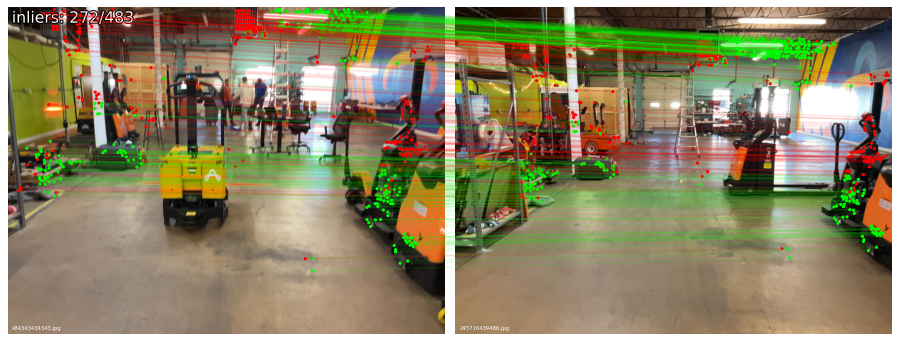

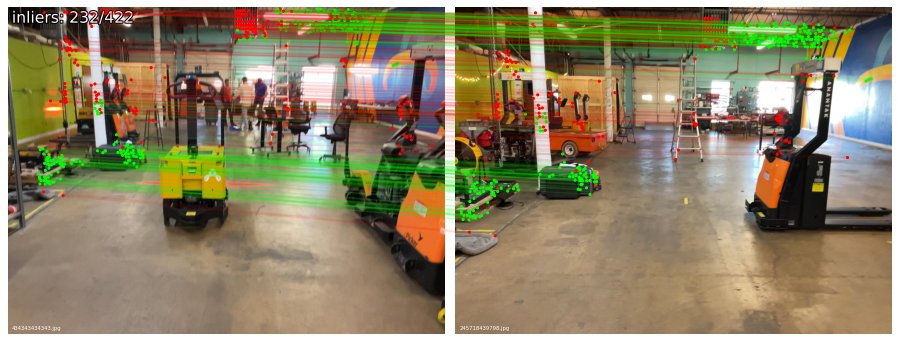

In [15]:
import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster
from hloc.utils.parsers import names_to_pair, names_to_pair_old, parse_retrieval

pairs = parse_retrieval(query_retrieval_pairs)
ref_matching_images = [r for q, rs in pairs.items() for r in rs]

ref_matching_image_ids = [model.find_image_with_name(r).image_id for r in ref_matching_images]
print(ref_matching_image_ids)

conf = {
    'estimation': {'ransac': {'max_error': 12}},
    'refinement': {'refine_focal_length': True, 'refine_extra_params': True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, query_camera, ref_matching_image_ids, query_features, query_matches)

print(f'found {ret["num_inliers"]}/{len(ret["inliers"])} inlier correspondences.')
visualization.visualize_loc_from_log(query_images, query, log, model, ref_images)


In [16]:
import numpy as np

R_vec = pycolmap.qvec_to_rotmat(ret['qvec'])
t_vec = ret['tvec']

_R_vec = R_vec.T
_t_vec = np.matmul(_R_vec, -t_vec)

ret_camera = pycolmap.Camera(camera_dict=ret['camera'])
ret_camera.calibration_matrix()

array([[1.58290600e+03, 0.00000000e+00, 9.53970000e+02],
       [0.00000000e+00, 1.69530854e+03, 7.18760000e+02],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

In [18]:

import plotly.graph_objects as go

fig = viz_3d.init_figure()

# Add axes at the origin
fig.add_trace(go.Scatter3d(
    x=[0, 1],
    y=[0, 0],
    z=[0, 0],
    mode="lines",
    line=dict(color="red", width=10),
    showlegend=False  # Hide from legend
))  # Positive X-axis

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 1],
    z=[0, 0],
    mode="lines",
    line=dict(color="green", width=10),
    showlegend=False
))  # Positive Y-axis

fig.add_trace(go.Scatter3d(
    x=[0, 0],
    y=[0, 0],
    z=[0, 1],
    mode="lines",
    line=dict(color="cyan", width=10),
    showlegend=False
))  # Positive Z-axis

# Set camera as BEV, in ARKit 
scene_camera = dict(
    up=dict(x=1, y=0, z=0),  # Up direction (default is z-axis)
    center=dict(x=0, y=0, z=0),  # Center of scene (default is origin)
    eye=dict(x=0, y=-5, z=0),  # Camera position (adjust as needed)
    projection=dict(type="perspective")
)
fig.update_layout(scene_camera=scene_camera)

viz_3d.plot_reconstruction(fig, model, color='rgba(255,0,0,0.5)', name="mapping", points_rgb=True)

viz_3d.plot_camera(fig,
                   _R_vec,
                   _t_vec,
                   ret_camera.calibration_matrix(),
                   'rgb(0,255,0)',
                   text='Query',
                   fill=True
                   )

fig.show()

## Match the query images

## Localize!
Perform hierarchical localization using the precomputed retrieval and matches. The file `Aachen_hloc_superpoint+superglue_netvlad50.txt` will contain the estimated query poses. Have a look at `Aachen_hloc_superpoint+superglue_netvlad50.txt_logs.pkl` to analyze some statistics and find failure cases.

In [ ]:
localize_sfm.main(
    reconstruction,
    dataset / 'queries/*_time_queries_with_intrinsics.txt',
    loc_pairs,
    features,
    loc_matches,
    results,
    covisibility_clustering=False)  # not required with SuperPoint+SuperGlue

## Visualizing the SfM model
We visualize some of the database images with their detected keypoints.

Color the keypoints by track length: red keypoints are observed many times, blue keypoints few.

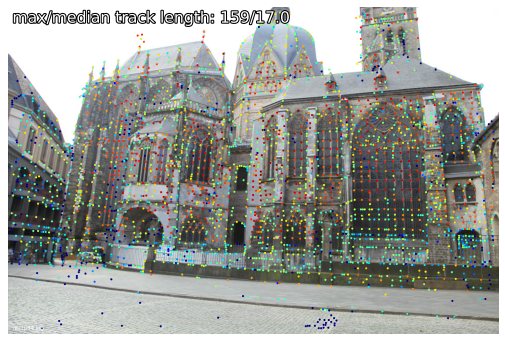

In [22]:
visualization.visualize_sfm_2d(reconstruction, images, n=1, color_by='track_length')

Color the keypoints by visibility: blue if sucessfully triangulated, red if never matched.

In [ ]:
visualization.visualize_sfm_2d(reconstruction, images, n=1, color_by='visibility')

Color the keypoints by triangulated depth: red keypoints are far away, blue keypoints are closer.

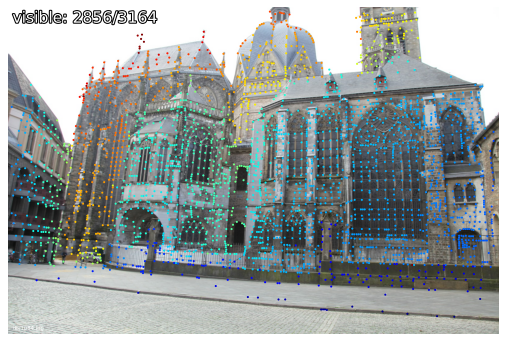

In [20]:
visualization.visualize_sfm_2d(reconstruction, images, n=1, color_by='depth')

## Visualizing the localization
We parse the localization logs and for each query image plot matches and inliers with a few database images.

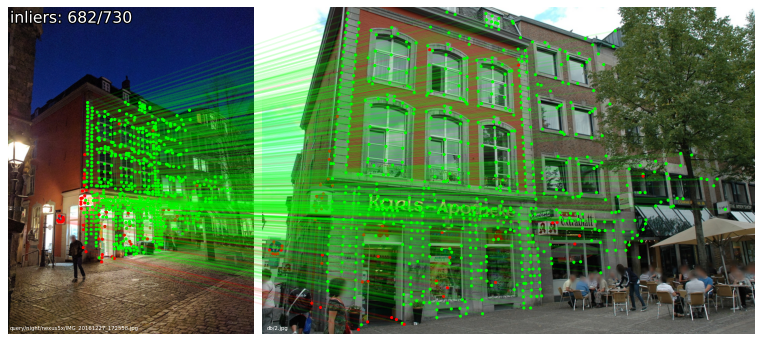

In [10]:
visualization.visualize_loc(
    results, images, reconstruction, n=1, top_k_db=1, prefix='query/night', seed=2)